<a href="https://colab.research.google.com/github/paulo-antunes-1/paulo-antunes-atmospheric-data/blob/main/BurnedArea_PM25/Mapa_de_BC_e_OC_por_estado.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install -q netCDF4 numpy xarray geopandas cartopy matplotlib contextily

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 131.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 76.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 107.9 MB/s eta 0:00:00


In [ ]:
import os
import glob
from netCDF4 import Dataset
import numpy as np
import xarray as xr
import geopandas as gpd
import cartopy.crs as ccrs
import cartopy as cart
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib import colors
import pandas as pd
from shapely.geometry import Point
import contextily as ctx

from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER

In [ ]:
# === 1. Abrir o arquivo NetCDF ===
df = xr.open_dataset('/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc')
df

<xarray.Dataset> Size: 71MB
Dimensions:                    (time: 84, lat: 361, lon: 576, latv: 2, lonv: 2)
Coordinates:
  * lat                        (lat) float64 3kB -90.0 -89.5 -89.0 ... 89.5 90.0
  * lon                        (lon) float64 5kB -180.0 -179.4 ... 178.8 179.4
Dimensions without coordinates: time, latv, lonv
Data variables:
    M2TMNXAER_5_12_4_BCEXTTAU  (time, lat, lon) float32 70MB ...
    lat_bnds                   (time, lat, latv) float64 485kB ...
    lon_bnds                   (time, lon, lonv) float64 774kB ...
Attributes:
    nco_openmp_thread_number:  1
    Conventions:               CF-1.4
    start_time:                2003-03-01T00:00:00Z
    end_time:                  2003-05-31T23:59:59Z
    NCO:                       netCDF Operators version 5.0.6 (Homepage = htt...
    history:                   Sat Nov 23 19:14:21 2024: ncks -O -x -v time_b...
    userstartdate:             2003-03-01T00:00:00Z
    userenddate:               2003-05-31T23:59:59Z
    title:                     Time Averaged Map of Black Carbon Extinction A...
    plot_hint_title:           Time Averaged Map of Black Carbon Extinction A...
    plot_hint_subtitle:        over 2003-Mar - 2003-May

In [ ]:
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")
mun.head()

,id,name,description,geometry
0,1100015,Alta Floresta D'Oeste,Alta Floresta D'Oeste,"POLYGON ((-62.18209 -11.86686, -62.1623 -11.87..."
1,1100023,Ariquemes,Ariquemes,"POLYGON ((-62.53595 -9.73182, -62.50782 -9.754..."
2,1100031,Cabixi,Cabixi,"POLYGON ((-60.3994 -13.45584, -60.40195 -13.46..."
3,1100049,Cacoal,Cacoal,"POLYGON ((-61.00051 -11.39796, -61.01794 -11.4..."
4,1100056,Cerejeiras,Cerejeiras,"POLYGON ((-61.50047 -13.00392, -61.47901 -13.0..."


/tmp/ipython-input-28-3388375811.py:20: UserWarning: The specified chunks separate the stored chunks along dimension "time" starting at index 1. This could degrade performance. Instead, consider rechunking after loading.
  ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})


Tempos usados no ano 2023: [Timestamp('2022-12-01 00:00:00'), Timestamp('2023-03-01 00:00:00'), Timestamp('2023-06-01 00:00:00'), Timestamp('2023-09-01 00:00:00')]
Total de pontos dentro dos estados: 2269


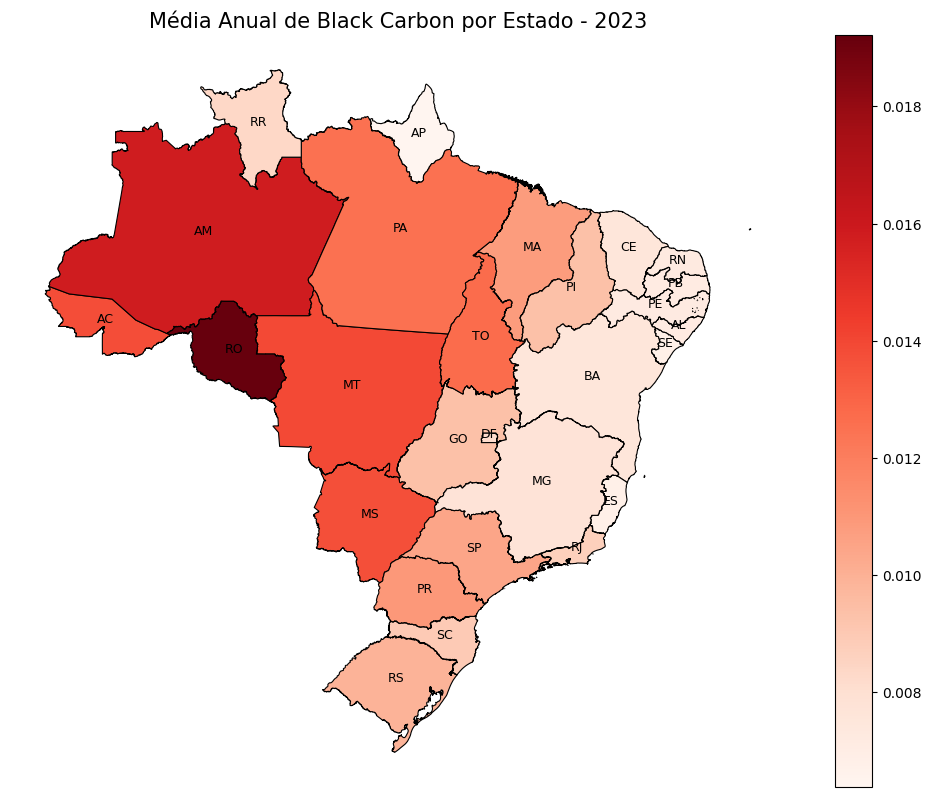

In [ ]:
import xarray as xr
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_ESTADOS = "/content/drive/MyDrive/QMODIS/br_states.json"
VARIAVEL = "M2TMNXAER_5_12_4_BCEXTTAU"
ANO_DESEJADO = 2023  # <<<<< ALTERE AQUI O ANO QUE DESEJA PLOTAR

# === 1. Criar as coordenadas de tempo corretamente ===
start_date = pd.Timestamp("2003-03-01")
periods = 84
freq = "3MS"  # início de cada trimestre
time_index = pd.date_range(start=start_date, periods=periods, freq=freq)

# === 2. Abrir o NetCDF e atribuir coordenadas de tempo ===
ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})
ds = ds.assign_coords(time=time_index)

# === 3. Selecionar os tempos que compõem o ano desejado ===
def obter_tempos_ano(ds, ano):
    tempos = ds.indexes['time']  # Correção: já é DatetimeIndex
    selecionados = []
    for t in tempos:
        mes = t.month
        ano_t = t.year
        if mes in [3, 6, 9] and ano_t == ano:
            selecionados.append(t)
        elif mes == 12 and ano_t == ano - 1:
            selecionados.append(t)  # DJF pertence ao ano seguinte
    return selecionados

tempos_ano = obter_tempos_ano(ds, ANO_DESEJADO)
print(f"Tempos usados no ano {ANO_DESEJADO}: {tempos_ano}")

# === 4. Subset do Dataset com os tempos selecionados ===
ds_ano = ds.sel(time=tempos_ano)
var_ano = ds_ano[VARIAVEL].mean(dim="time", skipna=True)

# === 5. Converter para DataFrame e montar GeoDataFrame ===
df = var_ano.to_dataframe().reset_index().dropna()
geometry = [Point(xy) for xy in zip(df['lon'], df['lat'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# === 6. Carregar estados brasileiros ===
estados = gpd.read_file(ARQUIVO_ESTADOS).to_crs("EPSG:4326")

# === 7. Spatial join: associar pontos aos estados ===
gdf_joined = gpd.sjoin(gdf, estados[['SIGLA', 'geometry']], how='inner', predicate='within')
print(f"Total de pontos dentro dos estados: {len(gdf_joined)}")

# === 8. Calcular média por estado ===
media_anual = gdf_joined.groupby('SIGLA')[VARIAVEL].mean().reset_index()
media_anual.rename(columns={VARIAVEL: "media_anual"}, inplace=True)
estados_media = estados.merge(media_anual, on="SIGLA", how="left")

# === 9. Plotar o mapa ===
fig, ax = plt.subplots(figsize=(10, 8))
estados_media.plot(column="media_anual", cmap="Reds", linewidth=0.8,
                   edgecolor='black', legend=True, ax=ax)

# Adicionar siglas no centro dos estados
for idx, row in estados_media.iterrows():
    if not pd.isna(row["media_anual"]):
        centroid = row['geometry'].centroid
        ax.text(centroid.x, centroid.y, row['SIGLA'], fontsize=9, ha='center', color='black')

plt.title(f"Média Anual de Black Carbon por Estado - {ANO_DESEJADO}", fontsize=15)
plt.axis("off")
plt.tight_layout()
plt.savefig(f"mapa_media_bc_{ANO_DESEJADO}.png", dpi=300)
plt.show()


/tmp/ipython-input-7-708343107.py:20: UserWarning: The specified chunks separate the stored chunks along dimension "time" starting at index 1. This could degrade performance. Instead, consider rechunking after loading.
  ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})


Tempos usados no ano 2023: [Timestamp('2022-12-01 00:00:00'), Timestamp('2023-03-01 00:00:00'), Timestamp('2023-06-01 00:00:00'), Timestamp('2023-09-01 00:00:00')]
Total de pontos dentro dos municípios: 2238


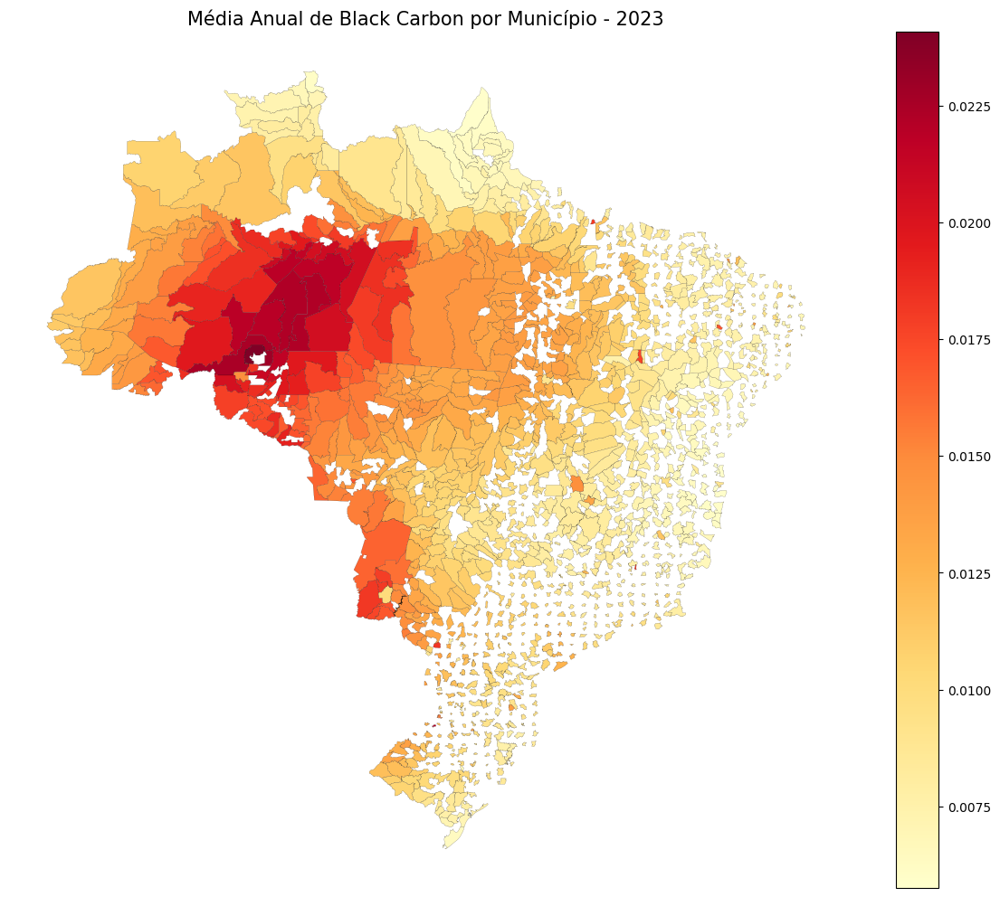

In [ ]:
import xarray as xr
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
VARIAVEL = "M2TMNXAER_5_12_4_BCEXTTAU"
ANO_DESEJADO = 2023  # <<<<< ALTERE AQUI O ANO QUE DESEJA PLOTAR

# === 1. Criar as coordenadas de tempo corretamente ===
start_date = pd.Timestamp("2003-03-01")
periods = 84
freq = "3MS"
time_index = pd.date_range(start=start_date, periods=periods, freq=freq)

# === 2. Abrir o NetCDF e atribuir coordenadas de tempo ===
ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})
ds = ds.assign_coords(time=time_index)

# === 3. Selecionar os tempos que compõem o ano desejado ===
def obter_tempos_ano(ds, ano):
    tempos = ds.indexes['time']
    selecionados = []
    for t in tempos:
        mes = t.month
        ano_t = t.year
        if mes in [3, 6, 9] and ano_t == ano:
            selecionados.append(t)
        elif mes == 12 and ano_t == ano - 1:
            selecionados.append(t)
    return selecionados

tempos_ano = obter_tempos_ano(ds, ANO_DESEJADO)
print(f"Tempos usados no ano {ANO_DESEJADO}: {tempos_ano}")

# === 4. Subset do Dataset com os tempos selecionados ===
ds_ano = ds.sel(time=tempos_ano)
var_ano = ds_ano[VARIAVEL].mean(dim="time", skipna=True)

# === 5. Converter para DataFrame e montar GeoDataFrame ===
df = var_ano.to_dataframe().reset_index().dropna()
geometry = [Point(xy) for xy in zip(df['lon'], df['lat'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# === 6. Carregar municípios ===
municipios = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")

# === 7. Spatial join: associar pontos aos municípios (usando 'name')
gdf_joined = gpd.sjoin(gdf, municipios[['name', 'geometry']], how='inner', predicate='within')
print(f"Total de pontos dentro dos municípios: {len(gdf_joined)}")

# === 8. Calcular média por município ===
media_anual = gdf_joined.groupby('name')[VARIAVEL].mean().reset_index()
media_anual.rename(columns={VARIAVEL: "media_anual"}, inplace=True)
municipios_media = municipios.merge(media_anual, on="name", how="left")

# === 9. Plotar o mapa ===
fig, ax = plt.subplots(figsize=(12, 10))
municipios_media.plot(column="media_anual", cmap="YlOrRd", linewidth=0.1,
                      edgecolor='black', legend=True, ax=ax)

plt.title(f"Média Anual de Black Carbon por Município - {ANO_DESEJADO}", fontsize=15)
plt.axis("off")
plt.tight_layout()
plt.savefig(f"mapa_media_bc_municipios_{ANO_DESEJADO}.png", dpi=300)
plt.show()


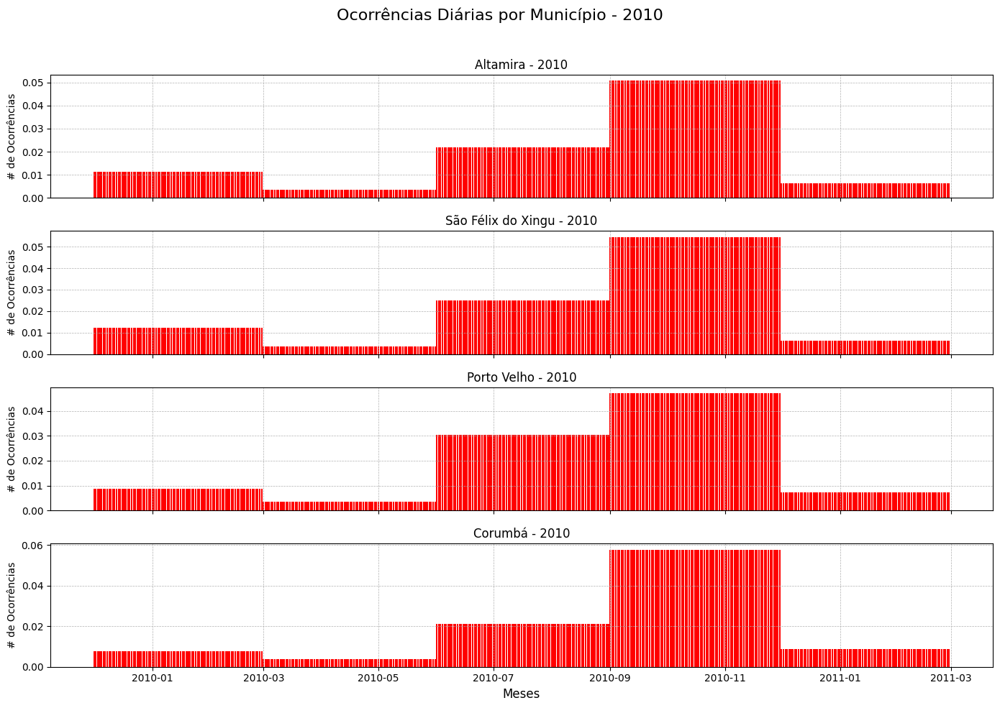

In [ ]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
variavel = "M2TMNXAER_5_12_4_BCEXTTAU"
ano_desejado = 2010
municipios_desejados = ["Altamira", "São Félix do Xingu", "Porto Velho", "Corumbá"]

# === 1. Abrir o Dataset e corrigir os tempos ===
ds = xr.open_dataset(ARQUIVO_NETCDF)
tempos_reais = pd.date_range("2003-03-01", periods=84, freq="3MS")
ds = ds.assign_coords(time=tempos_reais)

# === 2. Selecionar trimestres do ano desejado ===
tempos_ano = []
for t in tempos_reais:
    fim = t + pd.DateOffset(months=3) - pd.Timedelta(days=1)
    if t.year == ano_desejado or fim.year == ano_desejado:
        tempos_ano.append(t)

# === 3. Carregar shapefile dos municípios ===
gdf_mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")

# === 4. Processar cada trimestre e calcular valores médios por município ===
resultados = []

for tempo in tempos_ano:
    da = ds[variavel].sel(time=tempo)
    df_temp = da.to_dataframe().reset_index().dropna()
    geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
    gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

    gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
    medias = gdf_joined.groupby("name")[variavel].mean().reset_index()

    # Criar intervalo diário com valor constante
    inicio = tempo
    fim = tempo + pd.DateOffset(months=3) - pd.Timedelta(days=1)
    dias = pd.date_range(start=inicio, end=fim, freq='D')

    for _, row in medias.iterrows():
        for dia in dias:
            resultados.append({
                "data": dia,
                "municipio": row["name"],
                "valor": row[variavel]
            })

# === 5. Construir DataFrame final ===
df_final = pd.DataFrame(resultados)
df_final = df_final[df_final["municipio"].isin(municipios_desejados)]

# === 6. Plotagem ===
fig, axs = plt.subplots(len(municipios_desejados), 1, figsize=(14, 10), sharex=True)

for i, municipio in enumerate(municipios_desejados):
    df_mun = df_final[df_final["municipio"] == municipio]
    axs[i].bar(df_mun["data"], df_mun["valor"], color='red')
    axs[i].set_title(f"{municipio} - {ano_desejado}", fontsize=12)
    axs[i].set_ylabel("# de Ocorrências", fontsize=10)
    axs[i].grid(True, linestyle="--", linewidth=0.5)

axs[-1].set_xlabel("Meses", fontsize=12)
fig.suptitle(f"Ocorrências Diárias por Município - {ano_desejado}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


In [ ]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_ESTADOS = "/content/drive/MyDrive/QMODIS/br_states.json"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
variavel = "M2TMNXAER_5_12_4_BCEXTTAU"
ano_desejado = 2010

# Estados das regiões Norte e Centro-Oeste
estados_norte_co = ["RO", "AC", "AM", "RR", "PA", "AP", "TO", "MT", "MS", "GO", "DF"]

# === 1. Abrir Dataset e corrigir tempos ===
ds = xr.open_dataset(ARQUIVO_NETCDF)
tempos_reais = pd.date_range("2003-03-01", periods=84, freq="3MS")
ds = ds.assign_coords(time=tempos_reais)

tempos_ano = []
for t in tempos_reais:
    fim = t + pd.DateOffset(months=3) - pd.Timedelta(days=1)
    if t.year == ano_desejado or fim.year == ano_desejado:
        tempos_ano.append(t)

# === 2. Ler e filtrar estados e municípios ===
gdf_estados = gpd.read_file(ARQUIVO_ESTADOS).to_crs("EPSG:4326")
gdf_estados = gdf_estados[gdf_estados["SIGLA"].isin(estados_norte_co)]

gdf_mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")
gdf_mun = gpd.overlay(gdf_mun, gdf_estados, how='intersection')

# === 3. Processar dados por trimestre ===
dados_municipios = []
for tempo in tempos_ano:
    da = ds[variavel].sel(time=tempo)
    df_temp = da.to_dataframe().reset_index().dropna()
    geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
    gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

    gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
    medias = gdf_joined.groupby("name")[variavel].mean().reset_index()
    medias["data"] = tempo
    dados_municipios.append(medias)

# === 4. Concatenar resultados ===
df_total = pd.concat(dados_municipios)
municipios_unicos = df_total["name"].unique()

# === 5. Plotar ===
fig, axs = plt.subplots(len(municipios_unicos), 1, figsize=(14, len(municipios_unicos)*2.5), sharex=True)

if len(municipios_unicos) == 1:
    axs = [axs]

for i, municipio in enumerate(municipios_unicos):
    df_mun = df_total[df_total["name"] == municipio]
    axs[i].plot(df_mun["data"], df_mun[variavel], marker='o', color='red')
    axs[i].set_title(f"{municipio} - {ano_desejado}")
    axs[i].grid(True, linestyle='--', alpha=0.6)
    axs[i].set_ylabel("Média")

axs[-1].set_xlabel("Trimestres")
plt.suptitle(f"Média Trimestral de {variavel} - Municípios das Regiões Norte e Centro-Oeste - {ano_desejado}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


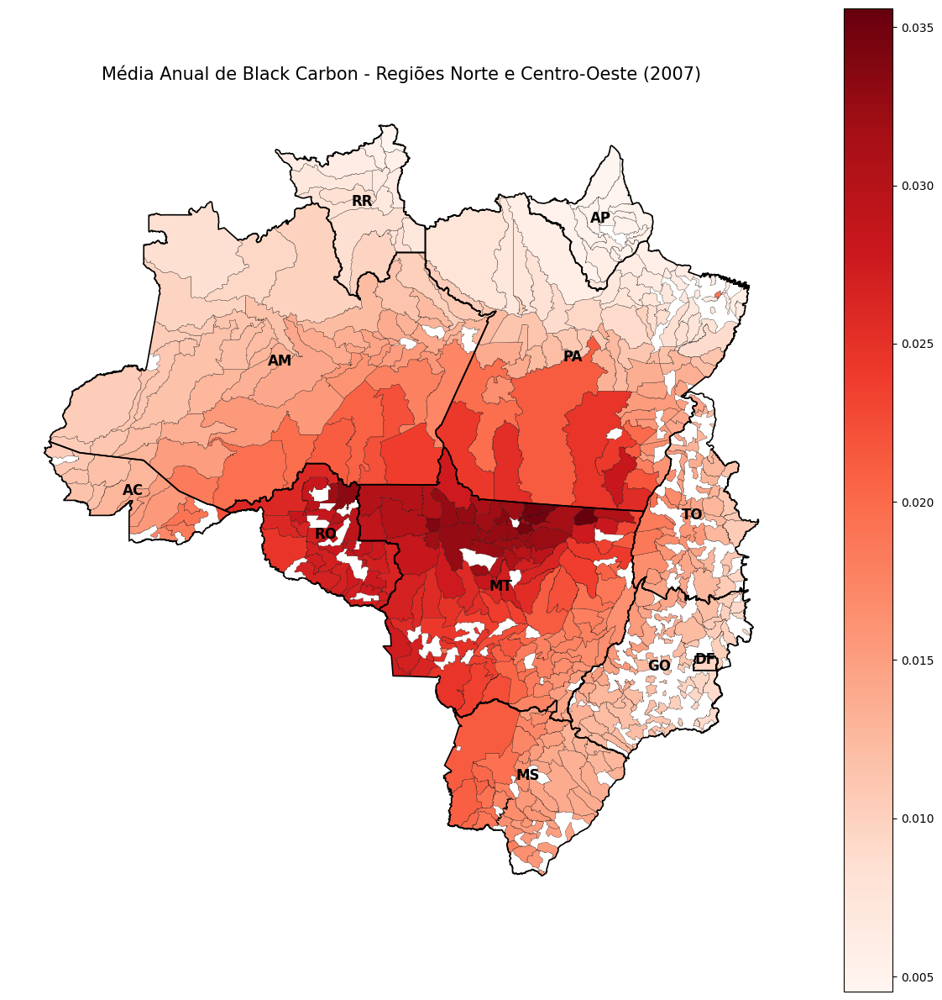

In [ ]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_ESTADOS = "/content/drive/MyDrive/QMODIS/br_states.json"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
variavel = "M2TMNXAER_5_12_4_BCEXTTAU"
ano_desejado = 2007

# === Regiões Norte e Centro-Oeste ===
estados_norte_co = ["RO", "AC", "AM", "RR", "PA", "AP", "TO", "MT", "MS", "GO", "DF"]

# === 1. Abrir e corrigir os tempos ===
ds = xr.open_dataset(ARQUIVO_NETCDF)
tempos_reais = pd.date_range("2003-03-01", periods=84, freq="3MS")
ds = ds.assign_coords(time=tempos_reais)

# === 2. Selecionar trimestres do ano desejado ===
tempos_ano = [t for t in tempos_reais if t.year == ano_desejado or (t + pd.DateOffset(months=3) - pd.Timedelta(days=1)).year == ano_desejado]

# === 3. Carregar shapefiles dos estados e municípios ===
gdf_estados = gpd.read_file(ARQUIVO_ESTADOS).to_crs("EPSG:4326")
gdf_estados = gdf_estados[gdf_estados["SIGLA"].isin(estados_norte_co)]

gdf_mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")
gdf_mun = gpd.overlay(gdf_mun, gdf_estados, how='intersection')

# === 4. Processar dados da variável para os municípios ===
dados_municipios = []

for tempo in tempos_ano:
    da = ds[variavel].sel(time=tempo)
    df_temp = da.to_dataframe().reset_index().dropna()
    geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
    gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

    # Spatial join entre pontos e municípios
    gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')

    # Média por município
    medias = gdf_joined.groupby("name")[variavel].mean().reset_index()

    # Merge para obter geometria de volta com segurança
    medias = medias.merge(gdf_mun[["name", "geometry"]], on="name", how="left")

    dados_municipios.append(medias)

# === 5. Média anual final por município ===
df_total = pd.concat(dados_municipios)
media_anual_mun = df_total.groupby("name")[[variavel]].mean().reset_index()
media_anual_mun = media_anual_mun.merge(gdf_mun[["name", "geometry"]], on="name", how="left")
gdf_media_mun = gpd.GeoDataFrame(media_anual_mun, geometry="geometry", crs="EPSG:4326")

# === 6. Plotar o mapa ===
fig, ax = plt.subplots(figsize=(12, 12))
gdf_estados.boundary.plot(ax=ax, edgecolor="black", linewidth=1.2)
gdf_media_mun.plot(column=variavel, cmap="Reds", legend=True, ax=ax, edgecolor="black", linewidth=0.2)

# Adicionar rótulos dos estados
for idx, row in gdf_estados.iterrows():
    centroid = row["geometry"].centroid
    ax.text(centroid.x, centroid.y, row["SIGLA"], fontsize=12, weight="bold", ha="center", color="black")

plt.title(f"Média Anual de Black Carbon - Regiões Norte e Centro-Oeste ({ano_desejado})", fontsize=15)
plt.axis("off")
plt.tight_layout()
plt.show()


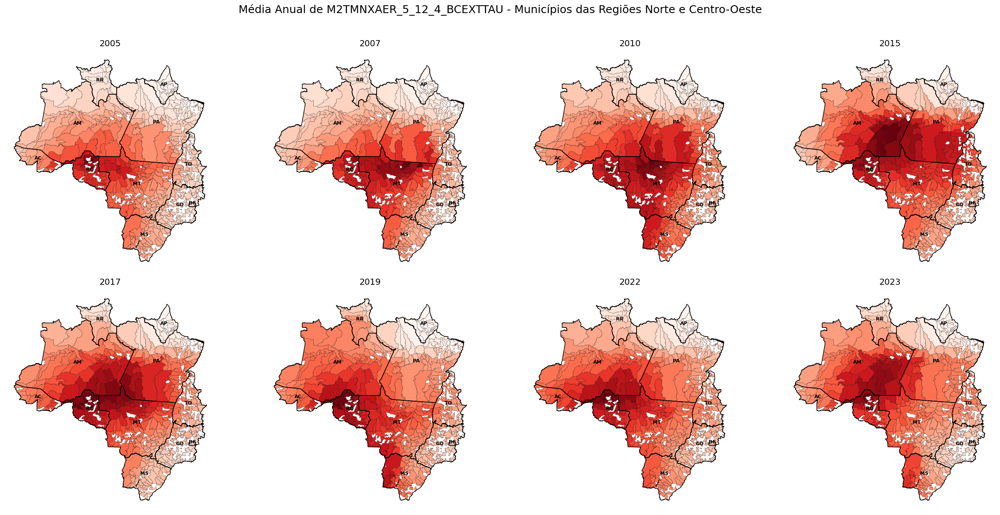

In [ ]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_ESTADOS = "/content/drive/MyDrive/QMODIS/br_states.json"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
variavel = "M2TMNXAER_5_12_4_BCEXTTAU"
estados_norte_co = ["RO", "AC", "AM", "RR", "PA", "AP", "TO", "MT", "MS", "GO", "DF"]
anos_desejados = [2005, 2007, 2010, 2015, 2017, 2019, 2022, 2023]

# === 1. Abrir NetCDF e corrigir os tempos ===
ds = xr.open_dataset(ARQUIVO_NETCDF)
tempos_reais = pd.date_range("2003-03-01", periods=84, freq="3MS")
ds = ds.assign_coords(time=tempos_reais)

# === 2. Ler e filtrar shapefiles ===
gdf_estados = gpd.read_file(ARQUIVO_ESTADOS).to_crs("EPSG:4326")
gdf_estados = gdf_estados[gdf_estados["SIGLA"].isin(estados_norte_co)]

gdf_mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")
gdf_mun = gpd.overlay(gdf_mun, gdf_estados, how='intersection')

# === 3. Painel de figuras ===
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(24, 12))
axes = axes.flatten()

for i, ano in enumerate(anos_desejados):
    tempos_ano = [t for t in tempos_reais if t.year == ano or (t + pd.DateOffset(months=3) - pd.Timedelta(days=1)).year == ano]
    dados_municipios = []

    for tempo in tempos_ano:
        da = ds[variavel].sel(time=tempo)
        df_temp = da.to_dataframe().reset_index().dropna()
        geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
        gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

        gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
        medias = gdf_joined.groupby("name")[variavel].mean().reset_index()
        medias = medias.merge(gdf_mun[["name", "geometry"]], on="name", how="left")
        dados_municipios.append(medias)

    df_total = pd.concat(dados_municipios)
    media_anual_mun = df_total.groupby("name")[[variavel]].mean().reset_index()
    media_anual_mun = media_anual_mun.merge(gdf_mun[["name", "geometry"]], on="name", how="left")
    gdf_media_mun = gpd.GeoDataFrame(media_anual_mun, geometry="geometry", crs="EPSG:4326")

    ax = axes[i]
    gdf_estados.boundary.plot(ax=ax, edgecolor="black", linewidth=1)
    gdf_media_mun.plot(column=variavel, cmap="Reds", ax=ax, edgecolor="black", linewidth=0.2)

    for idx, row in gdf_estados.iterrows():
        centroid = row["geometry"].centroid
        ax.text(centroid.x, centroid.y, row["SIGLA"], fontsize=8, weight="bold", ha="center", color="black")

    ax.set_title(f"{ano}", fontsize=14)
    ax.axis("off")

plt.suptitle(f"Média Anual de {variavel} - Municípios das Regiões Norte e Centro-Oeste", fontsize=18)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


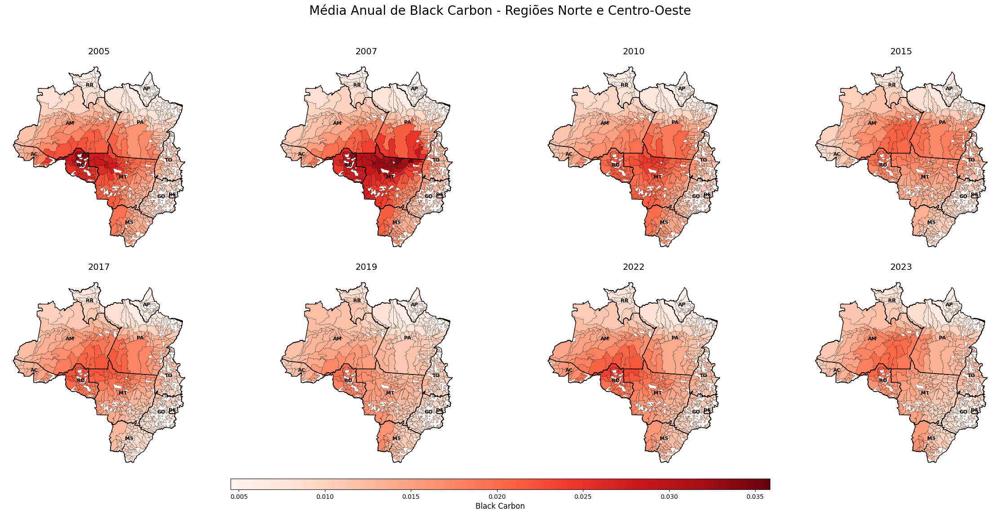

In [ ]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point
import matplotlib as mpl

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_ESTADOS = "/content/drive/MyDrive/QMODIS/br_states.json"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
variavel = "M2TMNXAER_5_12_4_BCEXTTAU"
estados_norte_co = ["RO", "AC", "AM", "RR", "PA", "AP", "TO", "MT", "MS", "GO", "DF"]
anos_desejados = [2005, 2007, 2010, 2015, 2017, 2019, 2022, 2023]

# === 1. Abrir NetCDF e corrigir os tempos ===
ds = xr.open_dataset(ARQUIVO_NETCDF)
tempos_reais = pd.date_range("2003-03-01", periods=84, freq="3MS")
ds = ds.assign_coords(time=tempos_reais)

# === 2. Ler e filtrar shapefiles ===
gdf_estados = gpd.read_file(ARQUIVO_ESTADOS).to_crs("EPSG:4326")
gdf_estados = gdf_estados[gdf_estados["SIGLA"].isin(estados_norte_co)]

gdf_mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")
gdf_mun = gpd.overlay(gdf_mun, gdf_estados, how='intersection')

# === 3. Painel de figuras ===
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(24, 12))
axes = axes.flatten()

# Predefinir limites de cor para a colorbar comum
vmin = None
vmax = None
media_anual_total = []

# Pré-processar todas as médias para achar vmin e vmax globais
for ano in anos_desejados:
    tempos_ano = [t for t in tempos_reais if t.year == ano or (t + pd.DateOffset(months=3) - pd.Timedelta(days=1)).year == ano]
    dados_municipios = []

    for tempo in tempos_ano:
        da = ds[variavel].sel(time=tempo)
        df_temp = da.to_dataframe().reset_index().dropna()
        geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
        gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

        gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
        medias = gdf_joined.groupby("name")[variavel].mean().reset_index()
        dados_municipios.append(medias)

    df_total = pd.concat(dados_municipios)
    media_anual = df_total.groupby("name")[[variavel]].mean().reset_index()
    media_anual_total.append(media_anual)

valores_todos = pd.concat(media_anual_total)[variavel]
vmin = valores_todos.min()
vmax = valores_todos.max()

# === 4. Criar os mapas ===
for i, ano in enumerate(anos_desejados):
    tempos_ano = [t for t in tempos_reais if t.year == ano or (t + pd.DateOffset(months=3) - pd.Timedelta(days=1)).year == ano]
    dados_municipios = []

    for tempo in tempos_ano:
        da = ds[variavel].sel(time=tempo)
        df_temp = da.to_dataframe().reset_index().dropna()
        geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
        gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

        gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
        medias = gdf_joined.groupby("name")[variavel].mean().reset_index()
        medias = medias.merge(gdf_mun[["name", "geometry"]], on="name", how="left")
        dados_municipios.append(medias)

    df_total = pd.concat(dados_municipios)
    media_anual_mun = df_total.groupby("name")[[variavel]].mean().reset_index()
    media_anual_mun = media_anual_mun.merge(gdf_mun[["name", "geometry"]], on="name", how="left")
    gdf_media_mun = gpd.GeoDataFrame(media_anual_mun, geometry="geometry", crs="EPSG:4326")

    ax = axes[i]
    gdf_estados.boundary.plot(ax=ax, edgecolor="black", linewidth=1)
    plotado = gdf_media_mun.plot(column=variavel, cmap="Reds", ax=ax, edgecolor="black", linewidth=0.2, vmin=vmin, vmax=vmax)

    for idx, row in gdf_estados.iterrows():
        centroid = row["geometry"].centroid
        ax.text(centroid.x, centroid.y, row["SIGLA"], fontsize=8, weight="bold", ha="center", color="black")

    ax.set_title(f"{ano}", fontsize=14)
    ax.axis("off")

# === 5. Adicionar colorbar horizontal ===
cax = fig.add_axes([0.25, 0.08, 0.5, 0.02])  # [esquerda, baixo, largura, altura]
sm = plt.cm.ScalarMappable(cmap="Reds", norm=mpl.colors.Normalize(vmin=vmin, vmax=vmax))
cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
cbar.set_label(f"Black Carbon", fontsize=12)

# === 6. Finalizar layout ===
plt.suptitle(f"Média Anual de Black Carbon - Regiões Norte e Centro-Oeste", fontsize=20)
plt.tight_layout(rect=[0, 0.1, 1, 0.95])
plt.show()


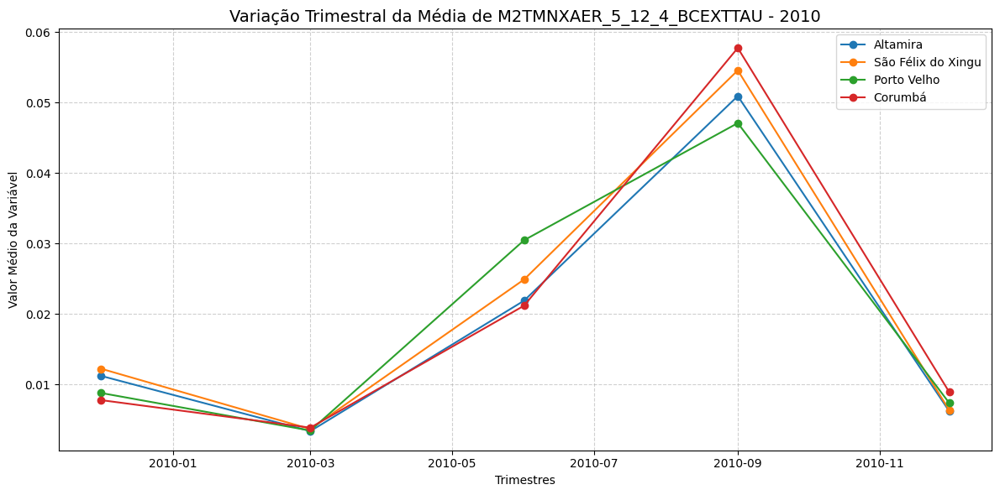

In [ ]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/BC/BC_MENSAL.nc"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
variavel = "M2TMNXAER_5_12_4_BCEXTTAU"
ano_desejado = 2010
municipios_desejados = ["Altamira", "São Félix do Xingu", "Porto Velho", "Corumbá"]

# === 1. Abrir o Dataset e corrigir os tempos ===
ds = xr.open_dataset(ARQUIVO_NETCDF)
tempos_reais = pd.date_range("2003-03-01", periods=84, freq="3MS")
ds = ds.assign_coords(time=tempos_reais)

# === 2. Selecionar trimestres do ano desejado ===
tempos_ano = []
for t in tempos_reais:
    fim = t + pd.DateOffset(months=3) - pd.Timedelta(days=1)
    if t.year == ano_desejado or fim.year == ano_desejado:
        tempos_ano.append(t)

# === 3. Carregar shapefile dos municípios ===
gdf_mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")

# === 4. Processar cada trimestre e calcular valores médios por município ===
dados_municipios = []

for tempo in tempos_ano:
    da = ds[variavel].sel(time=tempo)
    df_temp = da.to_dataframe().reset_index().dropna()
    geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
    gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

    gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
    medias = gdf_joined.groupby("name")[variavel].mean().reset_index()
    medias["data"] = tempo
    dados_municipios.append(medias)

# === 5. Unir todos os trimestres em um único DataFrame ===
df_total = pd.concat(dados_municipios)
df_total = df_total[df_total["name"].isin(municipios_desejados)]

# === 6. Plotagem ===
plt.figure(figsize=(12, 6))
for municipio in municipios_desejados:
    df_mun = df_total[df_total["name"] == municipio]
    plt.plot(df_mun["data"], df_mun[variavel], marker='o', label=municipio)

plt.title(f"Variação Trimestral da Média de {variavel} - {ano_desejado}", fontsize=14)
plt.xlabel("Trimestres")
plt.ylabel("Valor Médio da Variável")
plt.grid(True, linestyle="--", alpha=0.6)
plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
ds = xr.open_dataset('/content/drive/MyDrive/SAZONAL/OC/OC_MENSAL.nc')
ds

<xarray.Dataset> Size: 71MB
Dimensions:                    (time: 84, lat: 361, lon: 576, latv: 2, lonv: 2)
Coordinates:
  * lat                        (lat) float64 3kB -90.0 -89.5 -89.0 ... 89.5 90.0
  * lon                        (lon) float64 5kB -180.0 -179.4 ... 178.8 179.4
Dimensions without coordinates: time, latv, lonv
Data variables:
    M2TMNXAER_5_12_4_OCEXTTAU  (time, lat, lon) float32 70MB ...
    lat_bnds                   (time, lat, latv) float64 485kB ...
    lon_bnds                   (time, lon, lonv) float64 774kB ...
Attributes:
    NCO:                       netCDF Operators version 5.0.6 (Homepage = htt...
    nco_openmp_thread_number:  1
    Conventions:               CF-1.4
    start_time:                2003-03-01T00:00:00Z
    end_time:                  2003-05-31T23:59:59Z
    history:                   Sat Nov 23 19:14:19 2024: ncks -O -x -v time_b...
    userstartdate:             2003-03-01T00:00:00Z
    userenddate:               2003-05-31T23:59:59Z
    title:                     Time Averaged Map of Organic Carbon Extinction...
    plot_hint_title:           Time Averaged Map of Organic Carbon Extinction...
    plot_hint_subtitle:        over 2003-Mar - 2003-May

/tmp/ipython-input-14-2902923528.py:20: UserWarning: The specified chunks separate the stored chunks along dimension "time" starting at index 1. This could degrade performance. Instead, consider rechunking after loading.
  ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})


Tempos usados no ano 2023: [Timestamp('2022-12-01 00:00:00'), Timestamp('2023-03-01 00:00:00'), Timestamp('2023-06-01 00:00:00'), Timestamp('2023-09-01 00:00:00')]
Total de pontos dentro dos estados: 2269


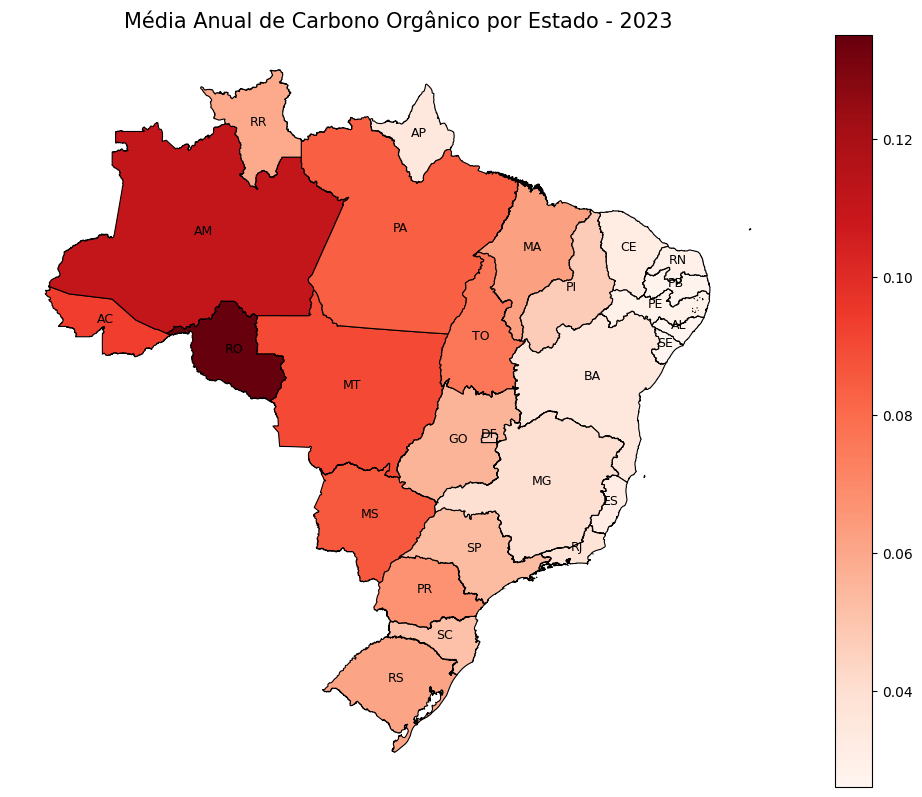

In [ ]:
import xarray as xr
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/OC/OC_MENSAL.nc"
ARQUIVO_ESTADOS = "/content/drive/MyDrive/QMODIS/br_states.json"
VARIAVEL = "M2TMNXAER_5_12_4_OCEXTTAU"
ANO_DESEJADO = 2023  # <<<<< ALTERE AQUI O ANO QUE DESEJA PLOTAR

# === 1. Criar as coordenadas de tempo corretamente ===
start_date = pd.Timestamp("2003-03-01")
periods = 84
freq = "3MS"  # início de cada trimestre
time_index = pd.date_range(start=start_date, periods=periods, freq=freq)

# === 2. Abrir o NetCDF e atribuir coordenadas de tempo ===
ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})
ds = ds.assign_coords(time=time_index)

# === 3. Selecionar os tempos que compõem o ano desejado ===
def obter_tempos_ano(ds, ano):
    tempos = ds.indexes['time']  # Correção: já é DatetimeIndex
    selecionados = []
    for t in tempos:
        mes = t.month
        ano_t = t.year
        if mes in [3, 6, 9] and ano_t == ano:
            selecionados.append(t)
        elif mes == 12 and ano_t == ano - 1:
            selecionados.append(t)  # DJF pertence ao ano seguinte
    return selecionados

tempos_ano = obter_tempos_ano(ds, ANO_DESEJADO)
print(f"Tempos usados no ano {ANO_DESEJADO}: {tempos_ano}")

# === 4. Subset do Dataset com os tempos selecionados ===
ds_ano = ds.sel(time=tempos_ano)
var_ano = ds_ano[VARIAVEL].mean(dim="time", skipna=True)

# === 5. Converter para DataFrame e montar GeoDataFrame ===
df = var_ano.to_dataframe().reset_index().dropna()
geometry = [Point(xy) for xy in zip(df['lon'], df['lat'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# === 6. Carregar estados brasileiros ===
estados = gpd.read_file(ARQUIVO_ESTADOS).to_crs("EPSG:4326")

# === 7. Spatial join: associar pontos aos estados ===
gdf_joined = gpd.sjoin(gdf, estados[['SIGLA', 'geometry']], how='inner', predicate='within')
print(f"Total de pontos dentro dos estados: {len(gdf_joined)}")

# === 8. Calcular média por estado ===
media_anual = gdf_joined.groupby('SIGLA')[VARIAVEL].mean().reset_index()
media_anual.rename(columns={VARIAVEL: "media_anual"}, inplace=True)
estados_media = estados.merge(media_anual, on="SIGLA", how="left")

# === 9. Plotar o mapa ===
fig, ax = plt.subplots(figsize=(10, 8))
estados_media.plot(column="media_anual", cmap="Reds", linewidth=0.8,
                   edgecolor='black', legend=True, ax=ax)

# Adicionar siglas no centro dos estados
for idx, row in estados_media.iterrows():
    if not pd.isna(row["media_anual"]):
        centroid = row['geometry'].centroid
        ax.text(centroid.x, centroid.y, row['SIGLA'], fontsize=9, ha='center', color='black')

plt.title(f"Média Anual de Carbono Orgânico por Estado - {ANO_DESEJADO}", fontsize=15)
plt.axis("off")
plt.tight_layout()
plt.savefig(f"mapa_media_bc_{ANO_DESEJADO}.png", dpi=300)
plt.show()


/tmp/ipython-input-21-3719674945.py:20: UserWarning: The specified chunks separate the stored chunks along dimension "time" starting at index 1. This could degrade performance. Instead, consider rechunking after loading.
  ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})


Tempos usados no ano 2023: [Timestamp('2022-12-01 00:00:00'), Timestamp('2023-03-01 00:00:00'), Timestamp('2023-06-01 00:00:00'), Timestamp('2023-09-01 00:00:00')]
Total de pontos dentro dos municípios: 2238


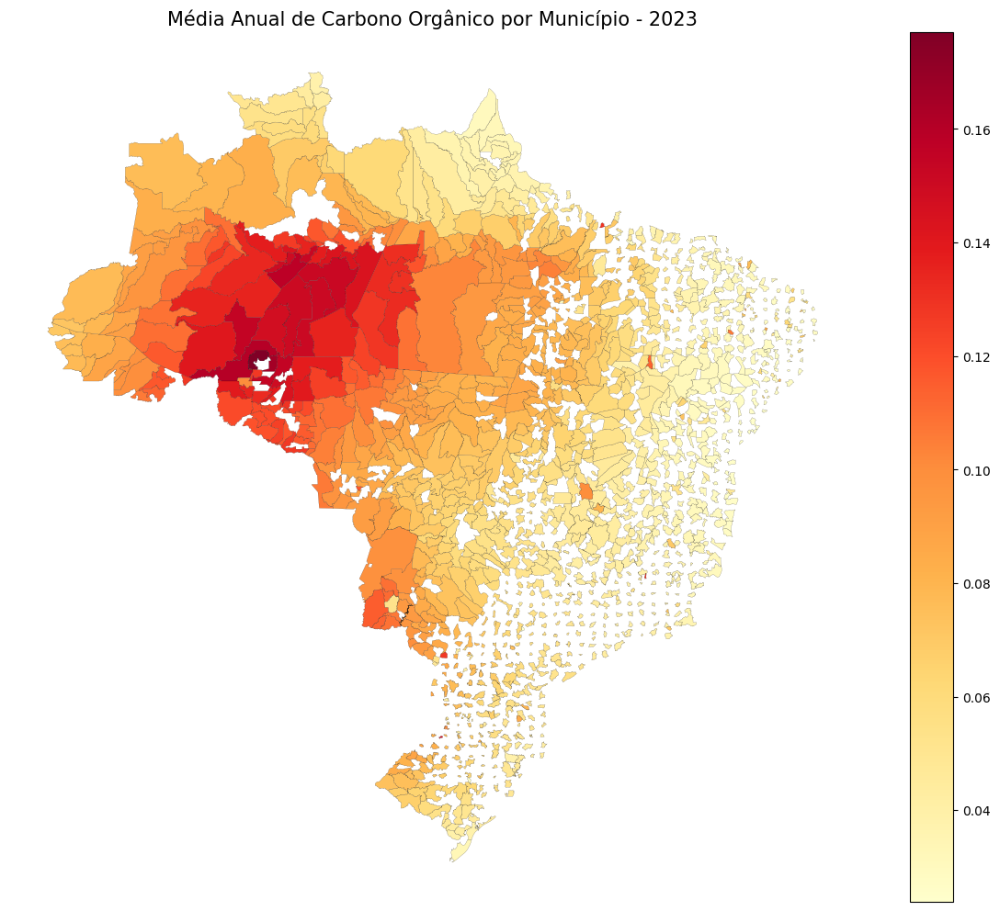

In [ ]:
import xarray as xr
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/OC/OC_MENSAL.nc"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
VARIAVEL = "M2TMNXAER_5_12_4_OCEXTTAU"
ANO_DESEJADO = 2023  # <<<<< ALTERE AQUI O ANO QUE DESEJA PLOTAR

# === 1. Criar as coordenadas de tempo corretamente ===
start_date = pd.Timestamp("2003-03-01")
periods = 84
freq = "3MS"
time_index = pd.date_range(start=start_date, periods=periods, freq=freq)

# === 2. Abrir o NetCDF e atribuir coordenadas de tempo ===
ds = xr.open_dataset(ARQUIVO_NETCDF, chunks={'time': 1})
ds = ds.assign_coords(time=time_index)

# === 3. Selecionar os tempos que compõem o ano desejado ===
def obter_tempos_ano(ds, ano):
    tempos = ds.indexes['time']
    selecionados = []
    for t in tempos:
        mes = t.month
        ano_t = t.year
        if mes in [3, 6, 9] and ano_t == ano:
            selecionados.append(t)
        elif mes == 12 and ano_t == ano - 1:
            selecionados.append(t)
    return selecionados

tempos_ano = obter_tempos_ano(ds, ANO_DESEJADO)
print(f"Tempos usados no ano {ANO_DESEJADO}: {tempos_ano}")

# === 4. Subset do Dataset com os tempos selecionados ===
ds_ano = ds.sel(time=tempos_ano)
var_ano = ds_ano[VARIAVEL].mean(dim="time", skipna=True)

# === 5. Converter para DataFrame e montar GeoDataFrame ===
df = var_ano.to_dataframe().reset_index().dropna()
geometry = [Point(xy) for xy in zip(df['lon'], df['lat'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry, crs="EPSG:4326")

# === 6. Carregar municípios ===
municipios = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")

# === 7. Spatial join: associar pontos aos municípios (usando 'name')
gdf_joined = gpd.sjoin(gdf, municipios[['name', 'geometry']], how='inner', predicate='within')
print(f"Total de pontos dentro dos municípios: {len(gdf_joined)}")

# === 8. Calcular média por município ===
media_anual = gdf_joined.groupby('name')[VARIAVEL].mean().reset_index()
media_anual.rename(columns={VARIAVEL: "media_anual"}, inplace=True)
municipios_media = municipios.merge(media_anual, on="name", how="left")

# === 9. Plotar o mapa ===
fig, ax = plt.subplots(figsize=(12, 10))
municipios_media.plot(column="media_anual", cmap="YlOrRd", linewidth=0.1,
                      edgecolor='black', legend=True, ax=ax)

plt.title(f"Média Anual de Carbono Orgânico por Município - {ANO_DESEJADO}", fontsize=15)
plt.axis("off")
plt.tight_layout()
plt.savefig(f"mapa_media_bc_municipios_{ANO_DESEJADO}.png", dpi=300)
plt.show()


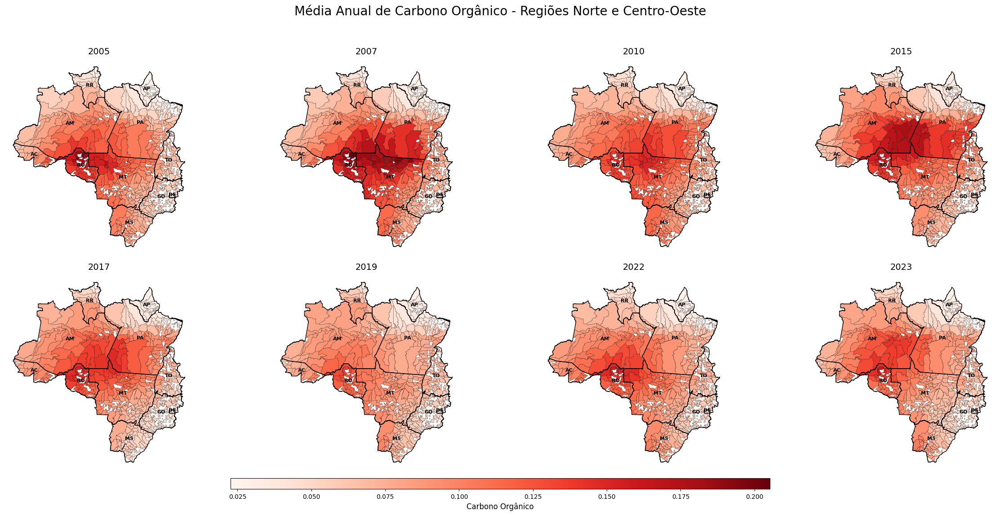

In [19]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import Point
import matplotlib as mpl

# === CONFIGURAÇÕES ===
ARQUIVO_NETCDF = "/content/drive/MyDrive/SAZONAL/OC/OC_MENSAL.nc"
ARQUIVO_ESTADOS = "/content/drive/MyDrive/QMODIS/br_states.json"
ARQUIVO_MUNICIPIOS = "/content/drive/MyDrive/QMODIS/mun.json"
variavel = "M2TMNXAER_5_12_4_OCEXTTAU"
estados_norte_co = ["RO", "AC", "AM", "RR", "PA", "AP", "TO", "MT", "MS", "GO", "DF"]
anos_desejados = [2005, 2007, 2010, 2015, 2017, 2019, 2022, 2023]

# === 1. Abrir NetCDF e corrigir os tempos ===
ds = xr.open_dataset(ARQUIVO_NETCDF)
tempos_reais = pd.date_range("2003-03-01", periods=84, freq="3MS")
ds = ds.assign_coords(time=tempos_reais)

# === 2. Ler e filtrar shapefiles ===
gdf_estados = gpd.read_file(ARQUIVO_ESTADOS).to_crs("EPSG:4326")
gdf_estados = gdf_estados[gdf_estados["SIGLA"].isin(estados_norte_co)]

gdf_mun = gpd.read_file(ARQUIVO_MUNICIPIOS).to_crs("EPSG:4326")
gdf_mun = gpd.overlay(gdf_mun, gdf_estados, how='intersection')

# === 3. Painel de figuras ===
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(24, 12))
axes = axes.flatten()

# Predefinir limites de cor para a colorbar comum
vmin = None
vmax = None
media_anual_total = []

# Pré-processar todas as médias para achar vmin e vmax globais
for ano in anos_desejados:
    tempos_ano = [t for t in tempos_reais if t.year == ano or (t + pd.DateOffset(months=3) - pd.Timedelta(days=1)).year == ano]
    dados_municipios = []

    for tempo in tempos_ano:
        da = ds[variavel].sel(time=tempo)
        df_temp = da.to_dataframe().reset_index().dropna()
        geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
        gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

        gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
        medias = gdf_joined.groupby("name")[variavel].mean().reset_index()
        dados_municipios.append(medias)

    df_total = pd.concat(dados_municipios)
    media_anual = df_total.groupby("name")[[variavel]].mean().reset_index()
    media_anual_total.append(media_anual)

valores_todos = pd.concat(media_anual_total)[variavel]
vmin = valores_todos.min()
vmax = valores_todos.max()

# === 4. Criar os mapas ===
for i, ano in enumerate(anos_desejados):
    tempos_ano = [t for t in tempos_reais if t.year == ano or (t + pd.DateOffset(months=3) - pd.Timedelta(days=1)).year == ano]
    dados_municipios = []

    for tempo in tempos_ano:
        da = ds[variavel].sel(time=tempo)
        df_temp = da.to_dataframe().reset_index().dropna()
        geometry = [Point(xy) for xy in zip(df_temp['lon'], df_temp['lat'])]
        gdf = gpd.GeoDataFrame(df_temp, geometry=geometry, crs="EPSG:4326")

        gdf_joined = gpd.sjoin(gdf, gdf_mun[['name', 'geometry']], how='inner', predicate='within')
        medias = gdf_joined.groupby("name")[variavel].mean().reset_index()
        medias = medias.merge(gdf_mun[["name", "geometry"]], on="name", how="left")
        dados_municipios.append(medias)

    df_total = pd.concat(dados_municipios)
    media_anual_mun = df_total.groupby("name")[[variavel]].mean().reset_index()
    media_anual_mun = media_anual_mun.merge(gdf_mun[["name", "geometry"]], on="name", how="left")
    gdf_media_mun = gpd.GeoDataFrame(media_anual_mun, geometry="geometry", crs="EPSG:4326")

    ax = axes[i]
    gdf_estados.boundary.plot(ax=ax, edgecolor="black", linewidth=1)
    plotado = gdf_media_mun.plot(column=variavel, cmap="Reds", ax=ax, edgecolor="black", linewidth=0.2, vmin=vmin, vmax=vmax)

    for idx, row in gdf_estados.iterrows():
        centroid = row["geometry"].centroid
        ax.text(centroid.x, centroid.y, row["SIGLA"], fontsize=8, weight="bold", ha="center", color="black")

    ax.set_title(f"{ano}", fontsize=14)
    ax.axis("off")

# === 5. Adicionar colorbar horizontal ===
cax = fig.add_axes([0.25, 0.08, 0.5, 0.02])  # [esquerda, baixo, largura, altura]
sm = plt.cm.ScalarMappable(cmap="Reds", norm=mpl.colors.Normalize(vmin=vmin, vmax=vmax))
cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
cbar.set_label(f"Carbono Orgânico", fontsize=12)

# === 6. Finalizar layout ===
plt.suptitle(f"Média Anual de Carbono Orgânico - Regiões Norte e Centro-Oeste", fontsize=20)
plt.tight_layout(rect=[0, 0.1, 1, 0.95])
plt.show()
